In [ ]:
!nvidia-smi

Thu Sep  7 14:58:09 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    26W / 300W |      0MiB / 16384MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

## Install basic toolkit

In [ ]:
!pip install -qq accelerate transformers safetensors opencv-python diffusers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 251.2/251.2 kB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 34.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 55.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 989.1/989.1 kB 54.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 27.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 68.7 MB/s eta 0:00:00


In [ ]:
!pip install -qq opencv-contrib-python
!pip install -qq controlnet_aux

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 202.4/202.4 kB 4.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.2/42.2 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 20.1 MB/s eta 0:00:00


In [ ]:
# For displaying images
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows * cols

    w, h = imgs[0].size
    grid = Image.new("RGB", size=(cols * w, rows * h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

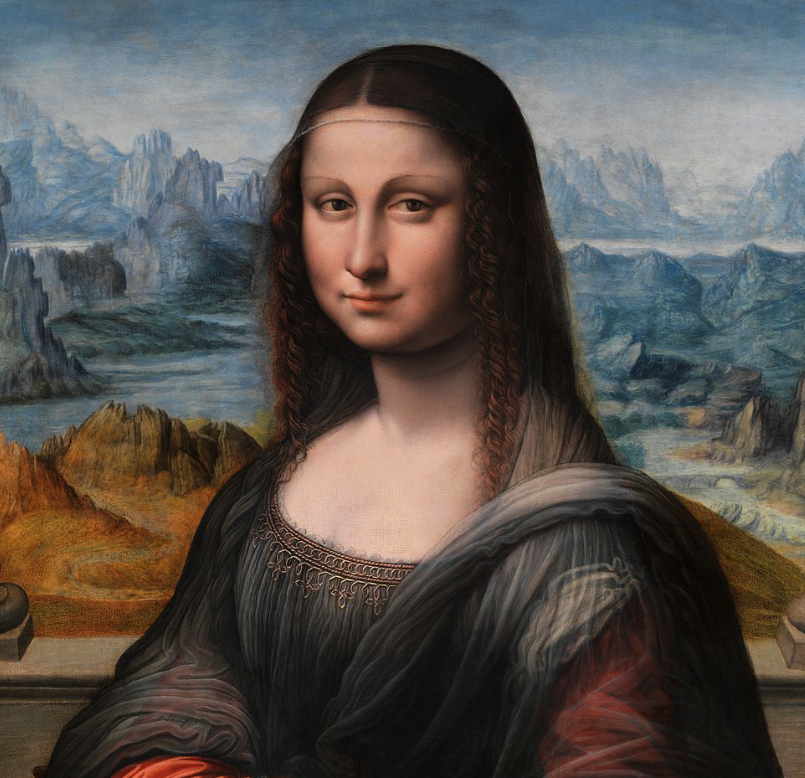

In [ ]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, AutoencoderKL, StableDiffusionXLControlNetPipeline
from diffusers.utils import load_image
from PIL import Image
import torch
import numpy as np
import cv2

# Load original image, you can also use your own image
original_image = load_image("https://media.discordapp.net/attachments/1092064974794391644/1194982468982427648/2c809fbfcb030dd8a97af3759f37ee29.png?ex=65b25526&is=659fe026&hm=93a959e1c5b1442d66dec7303e3a6ec48ea8e419e2c6ff0d7a580780b5bdd201&=&format=webp&quality=lossless&width=1041&height=1006").convert('RGB')
original_image

## Use SDXL's Canny control mode

In [ ]:
controlnet = ControlNetModel.from_pretrained(
    "diffusers/controlnet-Canny-sdxl-1.0-mid",
    torch_dtype=torch.float16
)
vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.float16)
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    controlnet=controlnet,
    vae=vae,
    torch_dtype=torch.float16,
)
pipe.enable_model_cpu_offload()

Fetching 17 files:   0%|          | 0/17 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

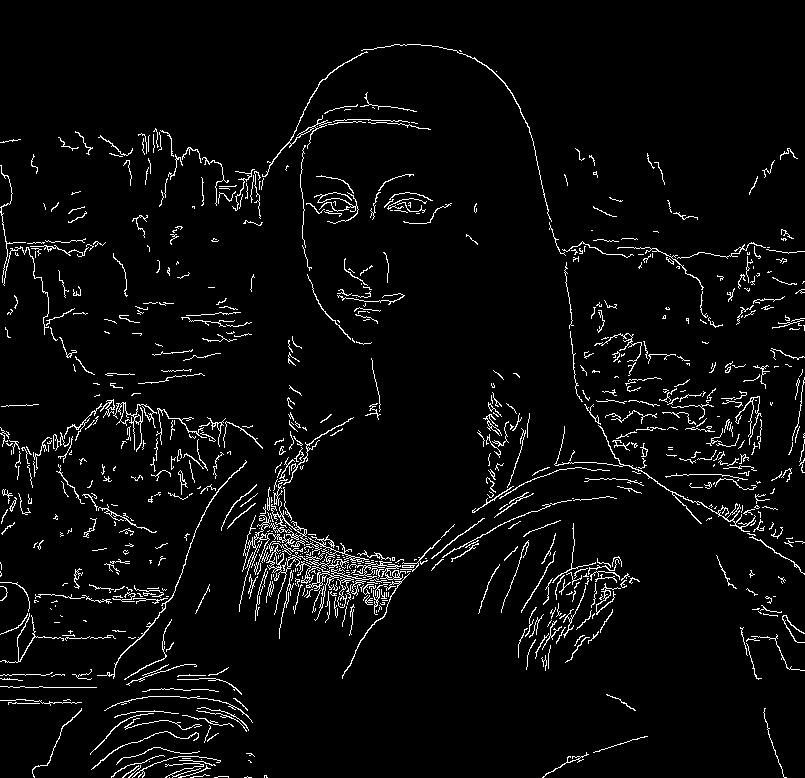

In [ ]:
# Extract Canny edges
image = np.array(original_image)
image = cv2.Canny(image, 100, 200)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
image = Image.fromarray(image)
image

In [ ]:
# Generate painting using ControlNet
prompt = "a smiling woman, winter backbround, cartoon style"
generator = torch.manual_seed(1025)
negative_prompt = "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, Normal quality, jpeg artifacts, signature, watermark, username, blurry"

controlnet_conditioning_scale = 0.6

images = pipe(
    [prompt]*2, num_inference_steps=50, negative_prompt=[negative_prompt]*2, image=image, controlnet_conditioning_scale=controlnet_conditioning_scale,generator = generator
).images

  0%|          | 0/50 [00:00<?, ?it/s]

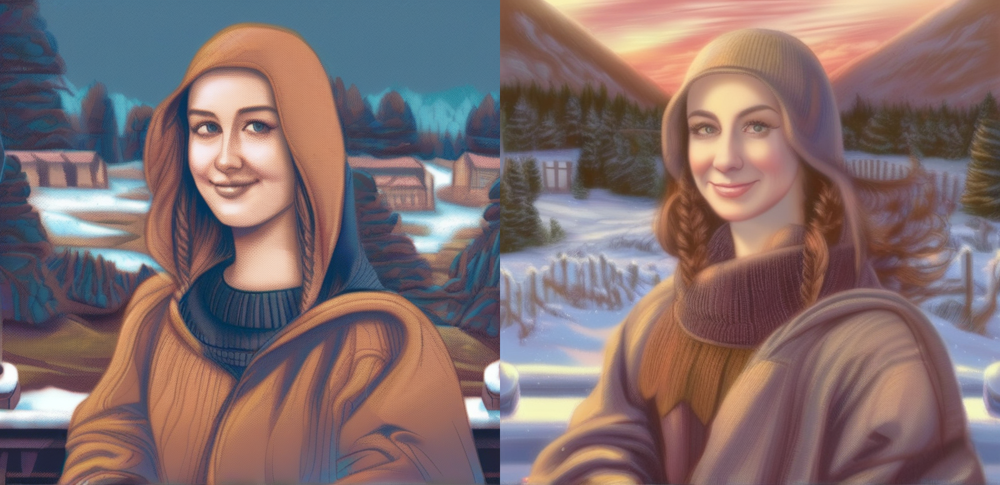

In [ ]:
image_grid(images, 1, 2)

In [ ]:
# Generate painting using ControlNet
prompt = "a smiling woman, summer backbround, van gogh style"
generator = torch.manual_seed(1025)
negative_prompt = "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, Normal quality, jpeg artifacts, signature, watermark, username, blurry"

controlnet_conditioning_scale = 0.6

images = pipe(
    [prompt]*2, num_inference_steps=50, negative_prompt=[negative_prompt]*2, image=image, controlnet_conditioning_scale=controlnet_conditioning_scale,generator = generator
).images

  0%|          | 0/50 [00:00<?, ?it/s]

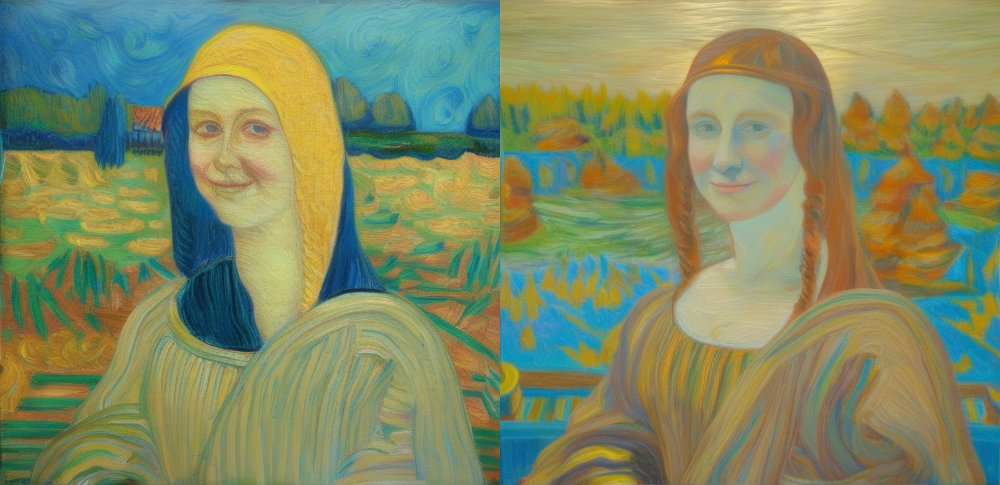

In [ ]:
image_grid(images, 1, 2)

In [ ]:
# Generate painting using ControlNet
prompt = "a smiling woman, busy city, cyberpunk style"
generator = torch.manual_seed(1025)
negative_prompt = "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, Normal quality, jpeg artifacts, signature, watermark, username, blurry"

controlnet_conditioning_scale = 0.6

images = pipe(
    [prompt]*2, num_inference_steps=50, negative_prompt=[negative_prompt]*2, image=image, controlnet_conditioning_scale=controlnet_conditioning_scale,generator = generator
).images

  0%|          | 0/50 [00:00<?, ?it/s]

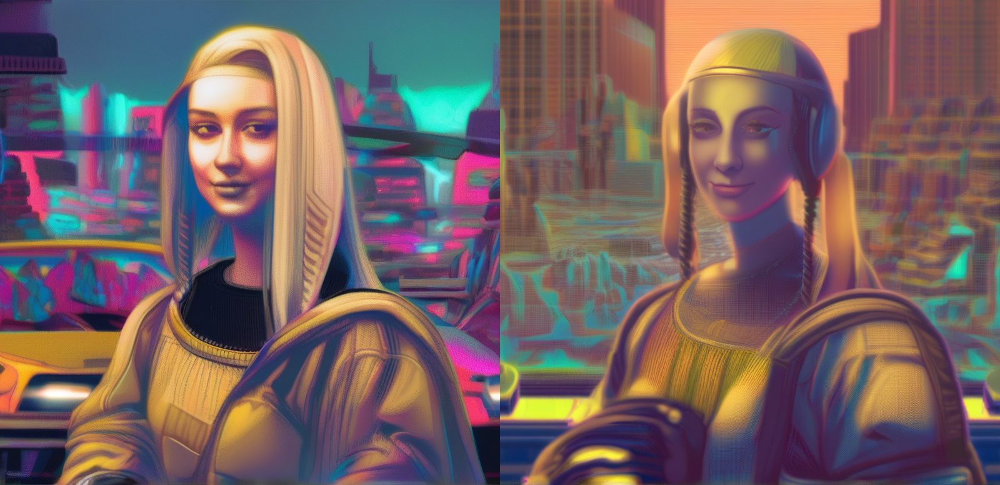

In [ ]:
image_grid(images, 1, 2)

In [ ]:
# Generate painting using ControlNet
prompt = "a smiling robot"
generator = torch.manual_seed(1025)
negative_prompt = "lowres, bad anatomy, bad hands, text, error, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, Normal quality, jpeg artifacts, signature, watermark, username, blurry"

controlnet_conditioning_scale = 0.6

images = pipe(
    [prompt]*2, num_inference_steps=50, negative_prompt=[negative_prompt]*2, image=image, controlnet_conditioning_scale=controlnet_conditioning_scale,generator = generator
).images

  0%|          | 0/50 [00:00<?, ?it/s]

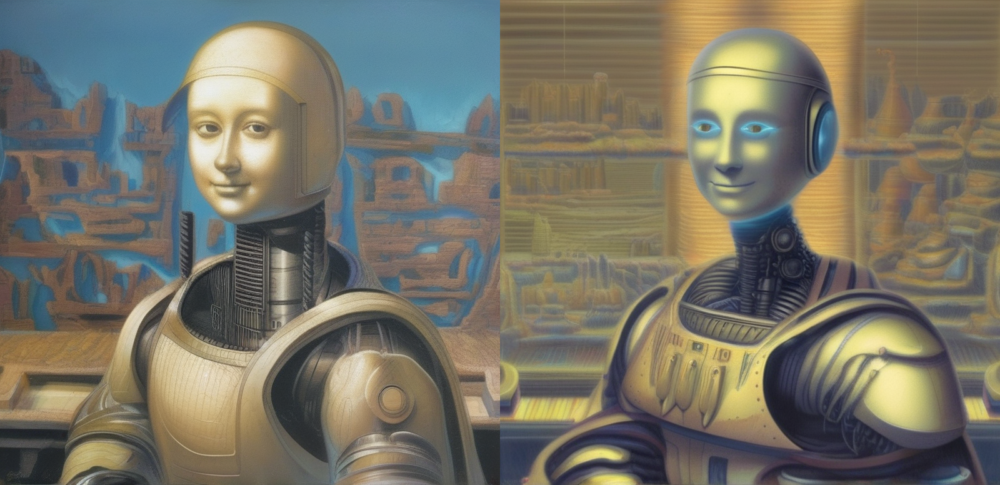

In [ ]:
image_grid(images, 1, 2)

## Use ControlNet prompt-based image editing mode

In [ ]:
checkpoint = "lllyasviel/control_v11e_sd15_ip2p"
controlnet = ControlNetModel.from_pretrained(checkpoint, torch_dtype=torch.float16)
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", controlnet=controlnet, torch_dtype=torch.float16
)

pipe.enable_model_cpu_offload()

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [ ]:
prompt = "make it spring"
generator = torch.manual_seed(0)
image_style1 = pipe(prompt, num_inference_steps=30, generator=generator, image=original_image).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
prompt = "make it summer"
generator = torch.manual_seed(0)
image_style2 = pipe(prompt, num_inference_steps=30, generator=generator, image=original_image).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
prompt = "make it autumn"
generator = torch.manual_seed(0)
image_style3 = pipe(prompt, num_inference_steps=30, generator=generator, image=original_image).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

In [ ]:
prompt = "make it winter"
generator = torch.manual_seed(0)
image_style4 = pipe(prompt, num_inference_steps=30, generator=generator, image=original_image).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

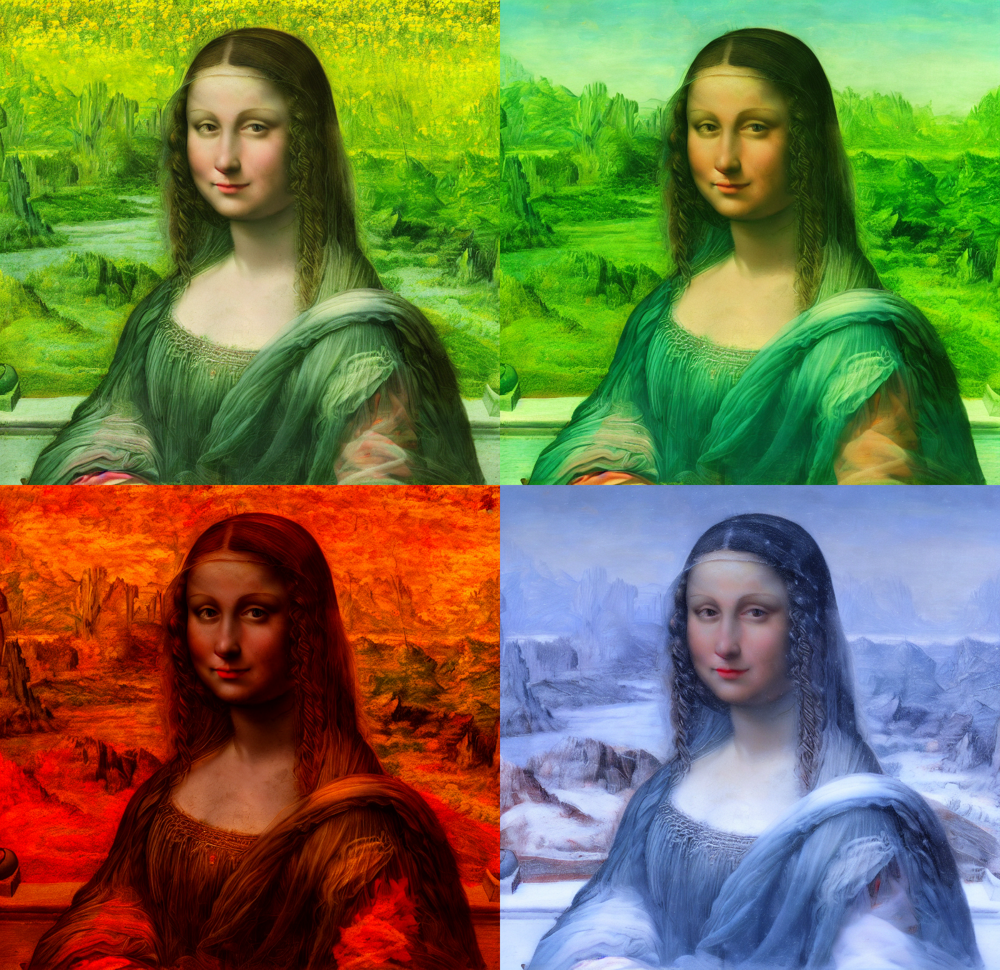

In [ ]:
image_grid([image_style1, image_style2, image_style3, image_style4], 2, 2)

  0%|          | 0/30 [00:00<?, ?it/s]

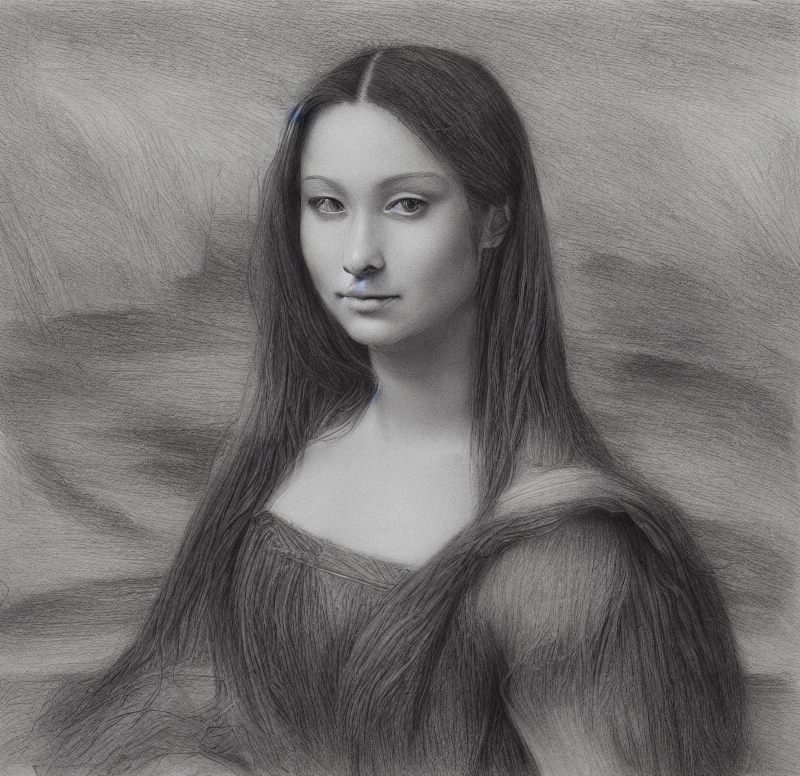

In [ ]:
prompt = "make it pencil drawing"
generator = torch.manual_seed(0)
image_style5 = pipe(prompt, guidance_scale = 1.5, control_guidance_start = 0.0, control_guidance_end = 1.0, num_inference_steps=30, generator=generator, image=original_image).images[0]
image_style5

  0%|          | 0/30 [00:00<?, ?it/s]

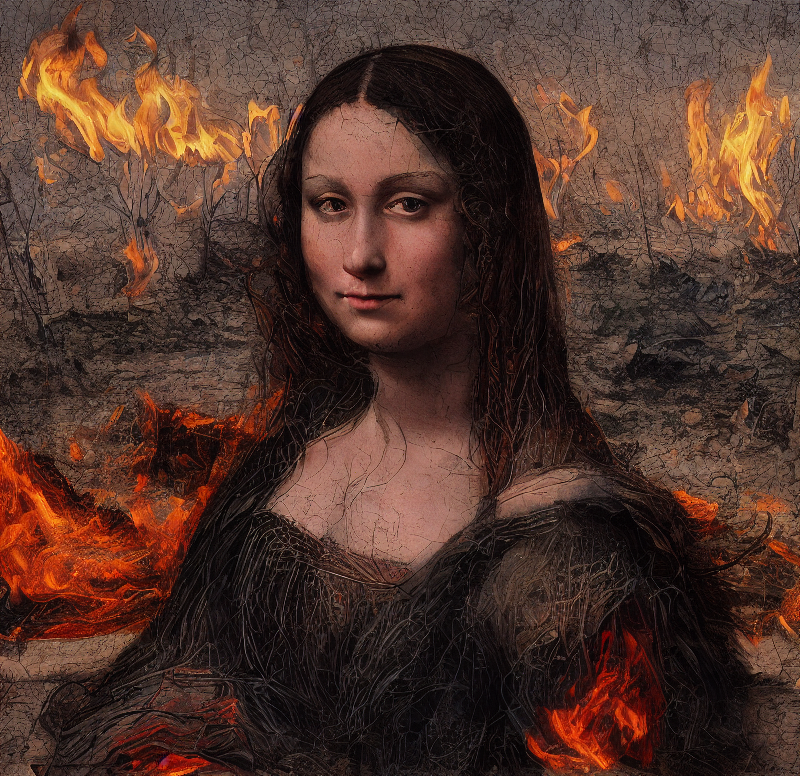

In [ ]:
prompt = "make it burning"
generator = torch.manual_seed(0)
image_style6 = pipe(prompt, guidance_scale = 3.0, num_inference_steps=30, generator=generator, image=original_image).images[0]
image_style6

  0%|          | 0/30 [00:00<?, ?it/s]

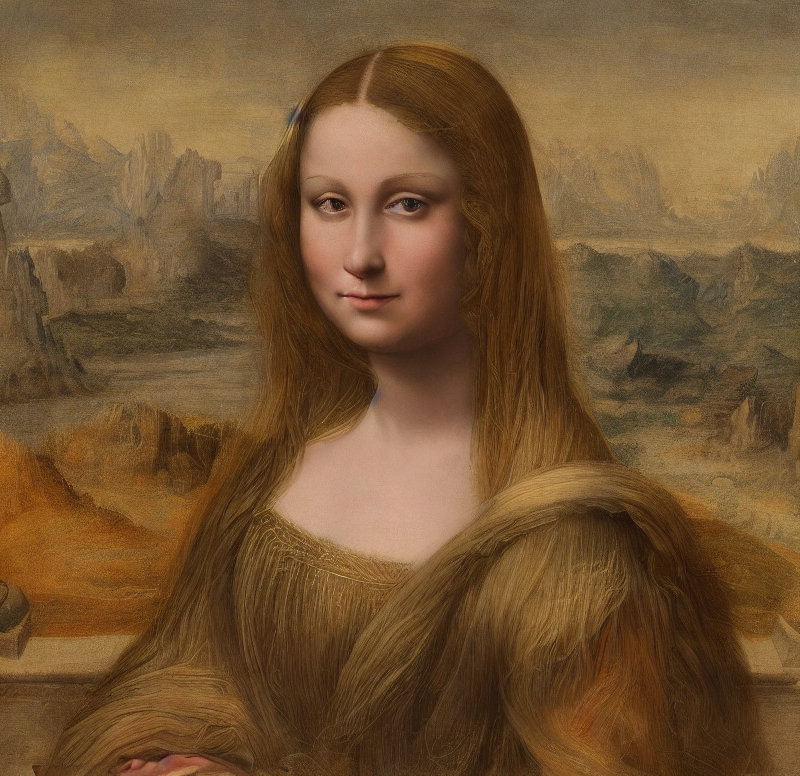

In [ ]:
prompt = "make her golden hair"
generator = torch.manual_seed(0)
image_style7 = pipe(prompt, guidance_scale = 2.0, num_inference_steps=30, generator=generator, image=original_image).images[0]
image_style7

  0%|          | 0/30 [00:00<?, ?it/s]

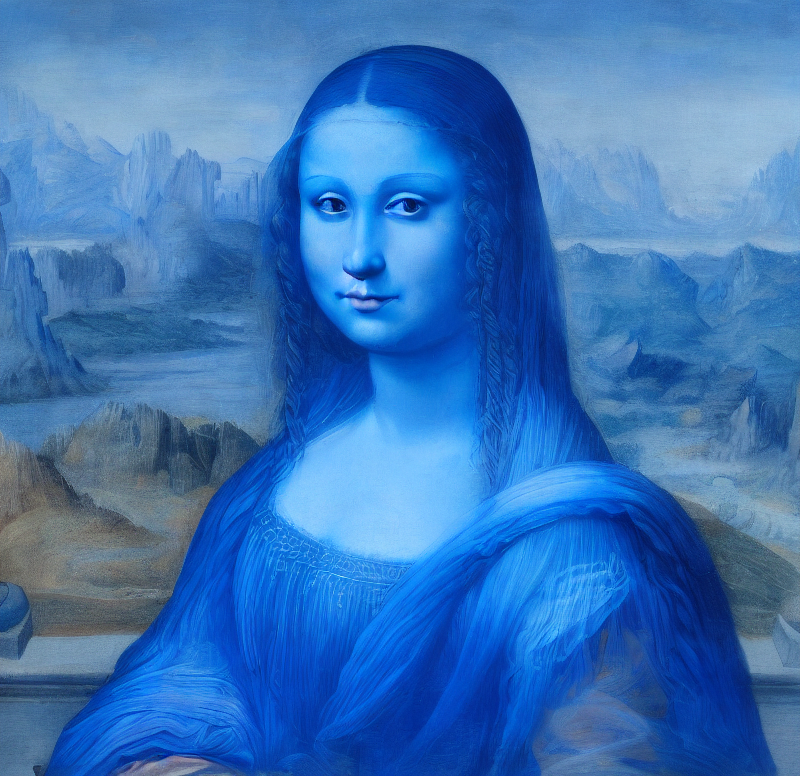

In [ ]:
prompt = "blue skin"
generator = torch.manual_seed(0)
image_style8 = pipe(prompt, guidance_scale = 3.0, num_inference_steps=30, generator=generator, image=original_image).images[0]
image_style8

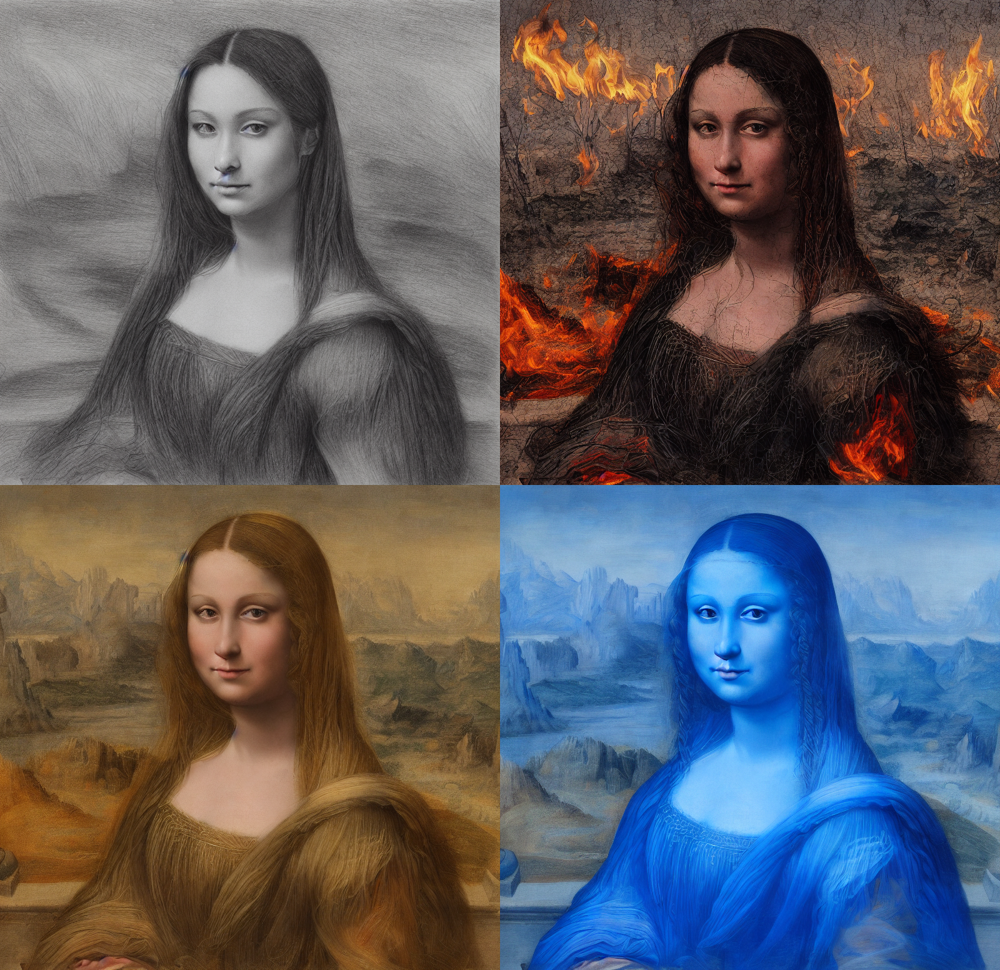

In [ ]:
image_grid([image_style5, image_style6, image_style7, image_style8], 2, 2)

In [ ]:
pipe?